<a href="https://colab.research.google.com/github/dssp-ethz/DSSP-Illustrations/blob/main/Frequency_Content_Of_Noise.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

*Notebook designed by Nicolas Menet in collaboration with Guy Revach.*

## The Recovered Audio File

In [1]:
pip install librosa

In [2]:
pip install pydsm

     |████████████████████████████████| 552 kB 15.9 MB/s 
  Created wheel for pydsm: filename=pydsm-0.14.0.0-cp37-cp37m-linux_x86_64.whl size=684739 sha256=06c44e0634855d01a17236f64d3e93b96b8f13f525bcd64861a963098cd7a03e
  Stored in directory: /root/.cache/pip/wheels/1d/37/8e/15939ed2fb3dcf8bbab167a0bf7c7155c2e6fa4df16d490260
Successfully built pydsm


In [3]:
!gdown https://drive.google.com/uc?id=1LPxXEJFpe-BJVt2fGUteUMZNq8bHeGf3
!gdown https://drive.google.com/uc?id=1937_NrN8dHRPEsAamOn7v6hBSWG1cwzt

Downloading...
From: https://drive.google.com/uc?id=1LPxXEJFpe-BJVt2fGUteUMZNq8bHeGf3
To: /content/slick_lick.wav
10.4MB [00:00, 25.1MB/s]
Downloading...
From: https://drive.google.com/uc?id=1937_NrN8dHRPEsAamOn7v6hBSWG1cwzt
To: /content/filters.py
100% 3.35k/3.35k [00:00<00:00, 2.53MB/s]


As a child you used to dream of becoming a rock star. You (and your friends) played a range of instruments. Being talented and eager to be noticed you recorded a few songs in the basement of your neighbour. However, as time progressed you developed a liking for electrical engineering and information science, forgot about your musical ambitions and invested fully into your eduction. Many years passed without you ever touching an instrument again. Whilst tidying up your attic you suddenly stumble upon an old tape recorder of you and your pals. You are able to read it into your computer (performing sampling), however dirt and dust have added a great amount of noise to it.

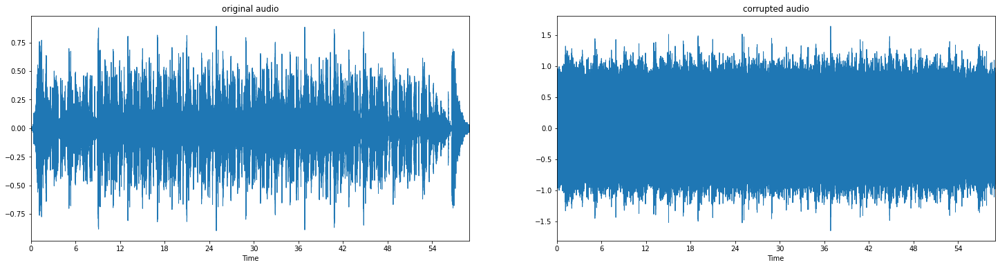

In [4]:
import IPython
import librosa, librosa.display
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib.collections import PolyCollection
import numpy as np

#path of the audio file
audio_data = 'slick_lick.wav'
#This returns an audio time series as a numpy array with a default sampling rate(sr) of 22KHZ
x, sample_rate = librosa.load(audio_data, sr=None)
#This is the audio that is corrupted by noise
x_noisy = x + np.random.normal(loc = 0, scale = 0.25, size = x.shape)


#plotting the sampled signal

from matplotlib.pyplot import figure

figure(figsize=(25, 6))

plt.subplot(1,2,1)
plt.title("original audio")
librosa.display.waveplot(x, sr=sample_rate);
plt.subplot(1,2,2)
plt.title("corrupted audio")
librosa.display.waveplot(x_noisy, sr=sample_rate);

You listen to the audio, but you mostly hear static. 

In [5]:
IPython.display.Audio(x_noisy, rate=sample_rate) # load a NumPy array

Suddenly you remember exactly what the recording must have sounded like. 

In [6]:
IPython.display.Audio(x, rate=sample_rate)

Wishing to recover the signal you analyze the distorted version in the frequency domain.


/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


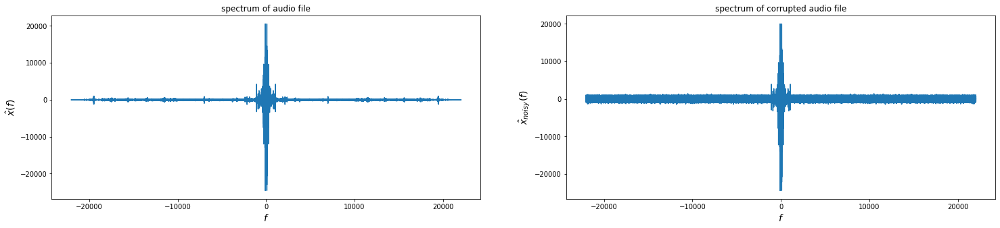

In [7]:
x_hat = np.fft.fft(x)
x_freq = np.fft.fftfreq(len(x), 1/sample_rate)

x_noisy_hat = np.fft.fft(x_noisy)
x_noisy_freq = np.fft.fftfreq(len(x_noisy), 1/sample_rate)

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(25, 5))
#plotting the sampled signal
ax[0].set_title('spectrum of audio file')
ax[0].set_xlabel('$f$', fontsize=14)
ax[0].set_ylabel('$\hat{x}(f)$', fontsize=14)
ax[0].plot(x_freq, x_hat)

ax[1].set_title('spectrum of corrupted audio file')
ax[1].set_xlabel('$f$', fontsize=14)
ax[1].set_ylabel('$\hat{x}_{noisy}(f)$', fontsize=14)
ax[1].plot(x_noisy_freq, x_noisy_hat)

Having seen many spectra before you may guess that the constant amplitude stems from noise (noise occurs at all frequencies) and you suspect that most of the relevant content is bandlimited (the human hearing range is from about 20 Hz to 20kHz, see https://en.wikipedia.org/wiki/Hearing_range). Thus you apply a low-pass filter to the audio hoping to remove some of the noise.

In [8]:
import filters
filters.widget()

interactive(children=(Dropdown(description='filter type', options=('low pass', 'high pass', 'band pass', 'all …

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/librosa/util/utils.py:200: UserWarning: librosa.util.frame called with axis=-1 on a non-contiguous input. This will result in a copy.
  "on a non-contiguous input. This will result in a copy.".format(axis)


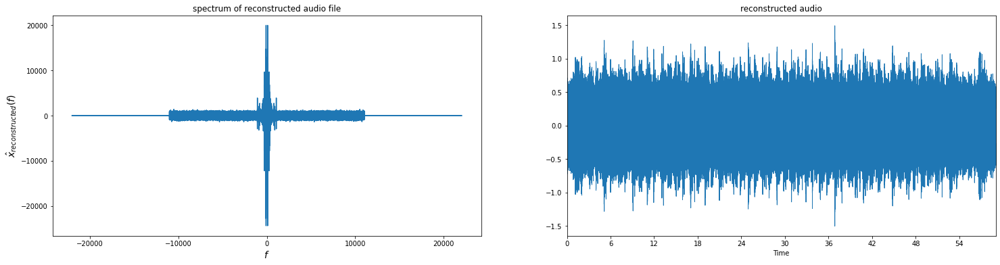

In [9]:
#def fft_filter(i, length):

x_reconstructed_hat = [x_noisy_hat[i] * filters.H(2*np.pi*x_noisy_freq[i]/sample_rate)  for i in range(len(x_noisy_hat))]
x_reconstructed_freq = x_noisy_freq

x_reconstructed = np.real(np.fft.ifft(x_reconstructed_hat))

figure(figsize=(25, 6))

plt.subplot(1,2,1)
#plotting the sampled signal
plt.title('spectrum of reconstructed audio file')
plt.xlabel('$f$', fontsize=14)
plt.ylabel('$\hat{x}_{reconstructed}(f)$', fontsize=14)
plt.plot(x_reconstructed_freq, x_reconstructed_hat)

plt.subplot(1,2,2)
plt.title("reconstructed audio")
librosa.display.waveplot(x_reconstructed, sr=sample_rate);

After selecting the right low pass filer you play the reconstructed recording, content that only little hissing can be heard. Although low-pass filtering removed some important information (compared to original) the beat and main melody can be heard much more clearly.

In [10]:
IPython.display.Audio(x_reconstructed, rate=sample_rate)

You send the recording to your group of friends. They are very reminiscent of old times and propose to play together some time, which makes you happy to have studied DSSP.

# (Operational) Power spectral density

We "cheated" in the example above. By always evaluating the gaussian noise we could effectively treat the noise as a determinate function in our analysis. However, what do we do when we want to perform a theoretical analysis of the spectrum involving a stochastic process?

You may thus wonder, how can we analyze the used frequencies of a stochastic process $X(\cdot)$? By their very nature stochastic processes are indeterminate and therefore one cannot analyze their spectrum. However, one can examine the expected power $\mathbb{E}[\text{power of } X * h]$ of the signal that we get when we apply a filter to $X$ (such as a bandpass filter if we are interested whether a frequency band is relevant enough to the stochastic process to impact its power). In the case of a continuous time stochastic process with power spectral density $S_{XX}$ one would get

$$\mathbb{E}[\text{Power in } X*h] = \int_{-\infty}^\infty S_{XX}(f)|h(f)|^2 df$$

see (Amos Lapidoth, A Foundation
in Digital Communication Second Edition, 2016, Section 15.3, Definition 15.3.1, p. 264).

Thus the power spectral density really just indicates, which frequencies one would expect to be present to some extent irrespective of the fact that in many cases all frequencies could theoretically be present. Although the concept has been explained using a continuous time stochastic process the intuition should follow to discrete time stochastic processes.